<a href="https://colab.research.google.com/github/NandaTobias56/Imers-o-de-dados/blob/main/Motor_de_Pesquisa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

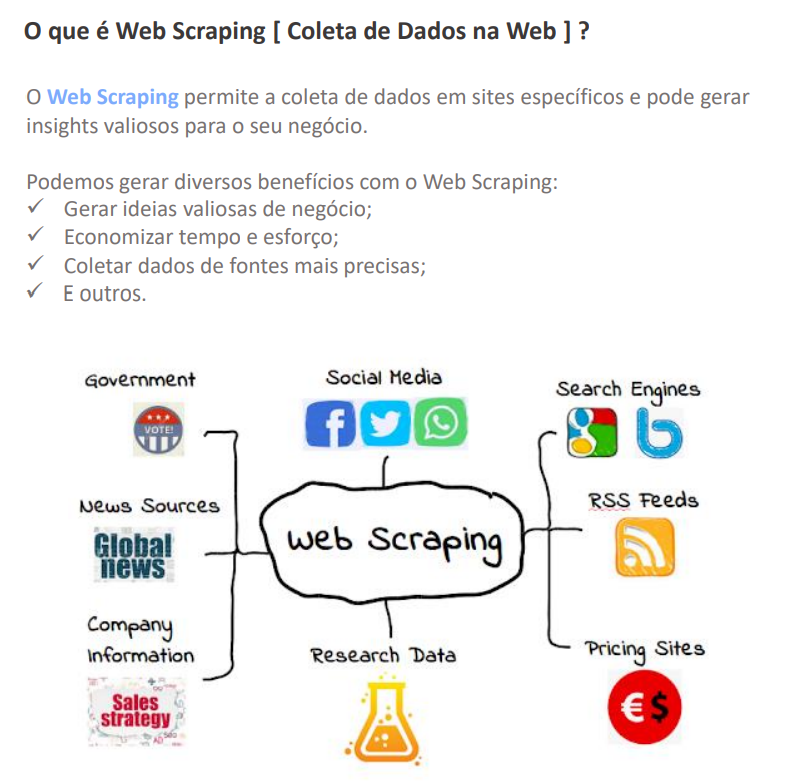

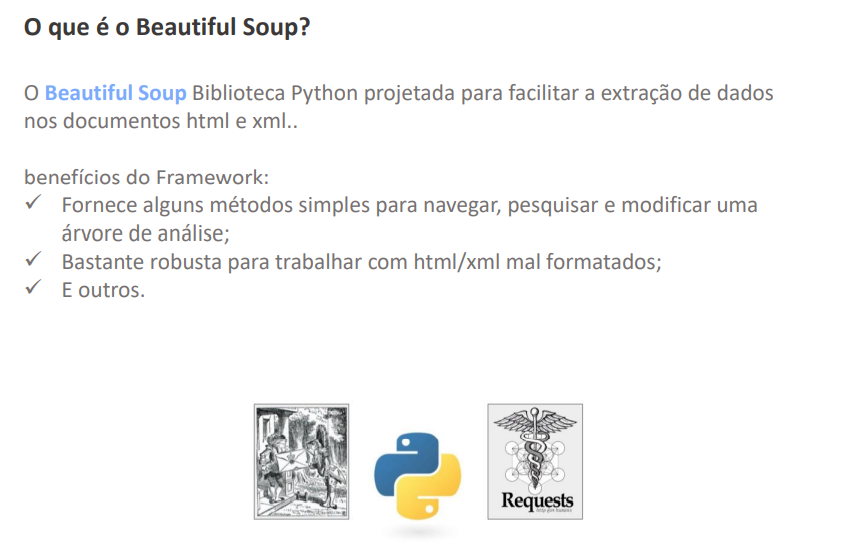

In [ ]:
 # Instala o pacote
!pip install WordCloud

In [ ]:
# Libs
import numpy as np
import pandas as pd

# Pacote para trabalhar com dados HTML e XML
from bs4 import BeautifulSoup

# Pacote para requisições HTTP
import requests

# Pacote para nuvem de palavras
from wordcloud import WordCloud

# Análises graficas
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Avisos
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Link do site
Site = 'https://news.google.com/search?for=americanas&hl=pt-BR&gl=BR&ceid=BR%3Apt-419'

# Requisição
Pagina = requests.get( Site )

type( Pagina )

requests.models.Response

In [ ]:
# Lendo os dados no BS
Coleta = BeautifulSoup( Pagina.text, 'html.parser' )

In [ ]:
# Titulo
Coleta.title.string

'Google Notícias - Pesquisar'

In [ ]:
Coleta.title.name

'title'

In [ ]:
# Pesquisa uma TAG na página
Coleta.find( class_='cp7Yvc' ).string

'Americanas suspende venda do Hortifruti Natural da Terra'

In [ ]:
Coleta.find( class_='cp7Yvc' ).name

'div'

In [ ]:
len( Coleta.find_all('a') )

310

In [ ]:
# Função
def Buscar_Empresas(ticket):

  # Criando um URL dinâmica
  Url = f'https://news.google.com/search?q={ticket}&hl=pt-BR&gl=BR&ceid=BR%3Apt-419'

  # Respostas pela requests
  Resposta = requests.get( Url )

  # Transformar em texto a resposta
  Codigo_HTML = Resposta.text

  # Converter
  Objeto_Soup = BeautifulSoup( Codigo_HTML, 'html.parser')

  return Objeto_Soup

In [ ]:
# Buscando os dados
Dados = Buscar_Empresas('Israel')

len( Dados )

4

In [ ]:
# Buscar os titulos H3
Elementos = Dados.find_all('h3')

len( Elementos )

89

In [ ]:
# Buscar os textos
Noticias = [ Texto.get_text() for Texto in Elementos ]

print('Noticias localizadas')
len( Noticias )

Noticias localizadas


89

In [ ]:
print('***' * 7 )
print('Noticias localizadas')
print('***' * 7 )

for Numero, Loop in enumerate( Noticias[0:5] ):
  print('--' * 10 )
  print( Numero, '-', Loop )

*********************
Noticias localizadas
*********************
--------------------
0 - G7 pede pausa humanitária na Faixa de Gaza, mas não menciona cessar-fogo em novo comunicado; ACOMPANHE
--------------------
1 - Sakamoto: Justificativa para fechar Rafah é muito conveniente para Israel
--------------------
2 - Conflito Israel-Hamas: 'Aqui é da inteligência de Israel. Temos ordem de bombardear. Vocês têm duas horas para sair'
--------------------
3 - Papo Antagonista: A ajuda de Israel à PF para prender terroristas
--------------------
4 - Mossad ajudou a PF em operação contra o Hezbollah, diz Israel


## NLP - Stops Words

In [ ]:
# Remover Stops Words

# Importar o NLTK
import nltk
from nltk.corpus import stopwords

# Download
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
# Palavras stopswords portugues
Lista_Palavras = stopwords.words('portuguese')

len( Lista_Palavras )

207

In [ ]:
type( Lista_Palavras )

list

In [ ]:
# Inclui palavras no Stop Words
Lista_Palavras.append('Odemir')
Lista_Palavras[-1]

'Odemir'

In [ ]:
Lista_Palavras[0:5]

['a', 'à', 'ao', 'aos', 'aquela']

In [ ]:
# Retirar as Stops Words

# String para junta todo o texto
Concatenar = ''
Lista_Palavras_Retiradas = []

# Loop nas Noticias
for Loop in Noticias[0:]:

  # Quebrar a frase em uma lista
  Quebra = Loop.split()

  # Rodar cada palavra da lista
  for Palavra in Quebra:

    # Verifique se a palavra não está na lista de stop words
    if Palavra.lower() not in Lista_Palavras:
      Concatenar = Concatenar + ' ' + Palavra.lower()

    else:
      Lista_Palavras_Retiradas.append( Palavra.lower() )

print( 'Total de palavras retiradas:', len(Lista_Palavras_Retiradas) )

Total de palavras retiradas: 355


In [ ]:
Concatenar

' g7 pede pausa humanitária faixa gaza, menciona cessar-fogo novo comunicado; acompanhe sakamoto: justificativa fechar rafah conveniente israel conflito israel-hamas: \'aqui inteligência israel. ordem bombardear. têm duas horas sair\' papo antagonista: ajuda israel pf prender terroristas mossad ajudou pf operação contra hezbollah, diz israel reinaldo: brasileiros gaza sendo feitos reféns israel embaixada israel convoca reunião deputados bolsonaristas apresentar ‘imagens exclusivas& ... bolsonaro reúne embaixador israel bolsonaro reúne embaixador israel deputados câmara eua dizem opor “reocupação” gaza israel netanyahu diz israel destruiu sede, túneis bases hamas \'resposta israel semelhante 11 setembro 2001\', diz reginaldo nasser israel, hamas, palestina: entenda guerra oriente médio israel-hamas: guia rápido entender conflito conflito israel-hamas: 5 conclusões após 4 semanas guerra polêmica fake news postada leticia sabatella sobre guerra israel exclusivo: porta-voz brasileiro exérc

## Contagem de Palavras

In [ ]:
# Contagem de palavras
from collections import Counter

# Dividir a string Concatenar em palavras
palavras = Concatenar.split()

# Contagem de palavrasa
contagem_palavras = Counter(palavras)

# Exibir as 5 palavras mais comuns
print(
    contagem_palavras.most_common(7)
)

[('israel', 71), ('hamas', 30), ('diz', 22), ('gaza', 20), ('guerra', 16), ('conflito', 7), ('israel-hamas:', 7)]


In [ ]:
# Cria o Data Frame
Anl_Palavras = pd.DataFrame( contagem_palavras, index=[0] ).transpose().reset_index()

# Renomea as colunas
Anl_Palavras.columns = ['Palavra', 'Quantidade']

# Ordenar
Anl_Palavras.sort_values( by='Quantidade', ascending=False, inplace=True )

Anl_Palavras

,Palavra,Quantidade
16,israel,71
68,hamas,30
39,diz,22
42,gaza,20
80,guerra,16
...,...,...
174,quarta,1
173,nesta,1
171,imagens,1
170,exibe,1


In [ ]:
# Representação
Anl_Palavras['%_Representação'] = Anl_Palavras.Quantidade.cumsum() / Anl_Palavras.Quantidade.sum() * 100
Anl_Palavras

,Palavra,Quantidade,%_Representação
16,israel,71,9.530201
68,hamas,30,13.557047
39,diz,22,16.510067
42,gaza,20,19.194631
80,guerra,16,21.342282
...,...,...,...
174,quarta,1,99.463087
173,nesta,1,99.597315
171,imagens,1,99.731544
170,exibe,1,99.865772


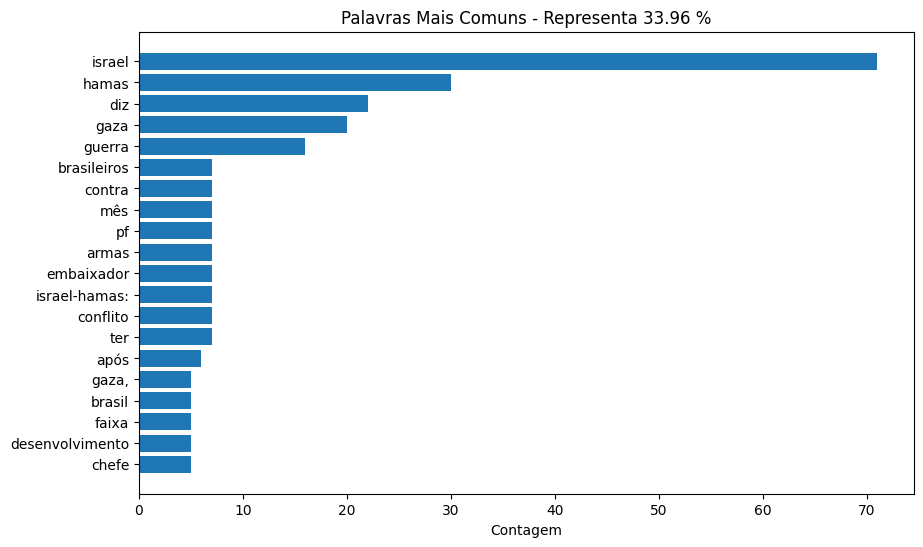

In [ ]:
# 20 Palavras mais citdads
Filtro_Top_20 = Anl_Palavras.head(20)
Titutlo_Max = round( Filtro_Top_20['%_Representação'].max(), 2 )

# Plot
plt.figure( figsize=(10, 6) )
plt.barh( Filtro_Top_20.Palavra, Filtro_Top_20.Quantidade )
plt.xlabel('Contagem')
plt.title(f'Palavras Mais Comuns - Representa { Titutlo_Max } %')
plt.gca().invert_yaxis()  # Inverter a ordem das palavras mais comuns
plt.show()

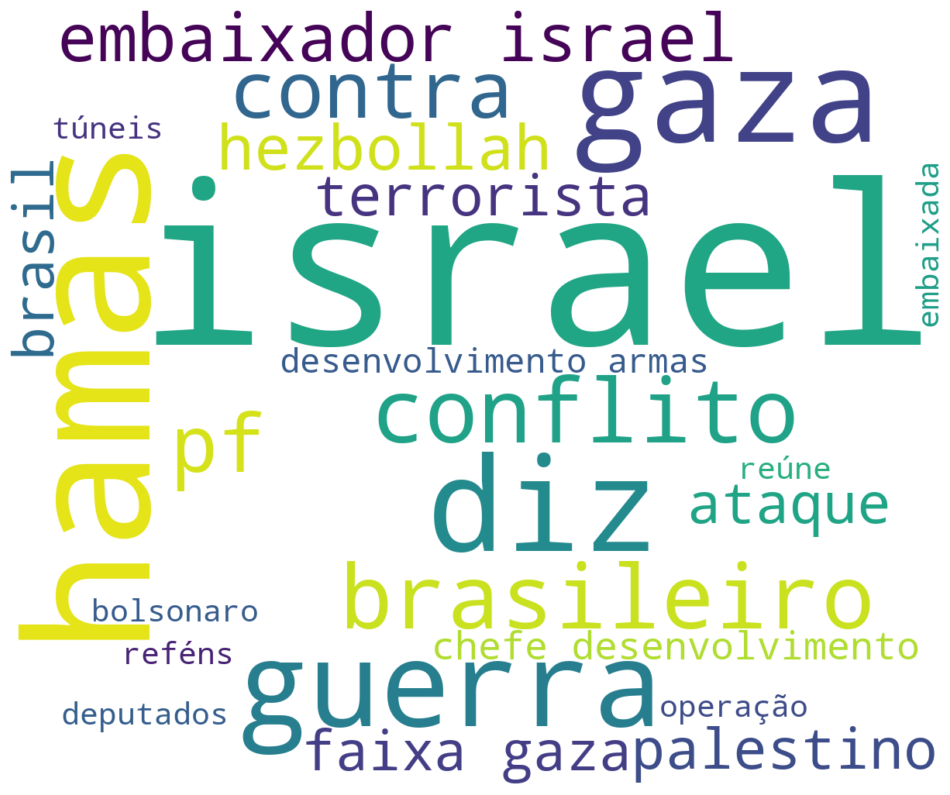

In [ ]:
## Nuvem de Palavras
Nuvem_Palavras = WordCloud(
    # Tamanho
    width=1200,
    height=1000,
    # Max de palavras
    max_words=25,
    # Tamanho min de palavras
    min_font_size=8,
    # fundo
    background_color='white',
    stopwords=['após', 'mês', 'ter']
).generate( Concatenar )

# Plot

# Crio a Figura
Figura, Eixo = plt.subplots( figsize=(12, 18) )
# PLOT das palabras
Eixo.imshow( Nuvem_Palavras, interpolation='bilinear' )
# Retiro os eixos
Eixo.set_axis_off()

# Exportando o gráfico
plt.savefig('Analise_Nuvem_Palavras.jpg', format='jpg')

In [ ]:
# Dados do cabeçalho e valores
cabecalho = ['Noticia']
valores = Noticias[0:10]

LinhaBranca = 'white'
LinhaAzul = 'paleturquoise'

# Criação da tabela
tabela = go.Figure(
    data=[
        go.Table(
            header=dict( values=cabecalho, fill_color='RoyalBlue', font_color='white', height=40, align='left', font_size=10 ),
            cells=dict( values=[valores], height=30, align='left', line_color='#f5f5f5', font_size=10,
                       fill_color=[[LinhaBranca, LinhaAzul, LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul ]] )
        )
    ]
)

# Configurações de layout da tabela
tabela.update_layout(
    title='Principais Noticías',
    width=1000,
    height=700
)

# Exibindo a tabela
tabela.show()

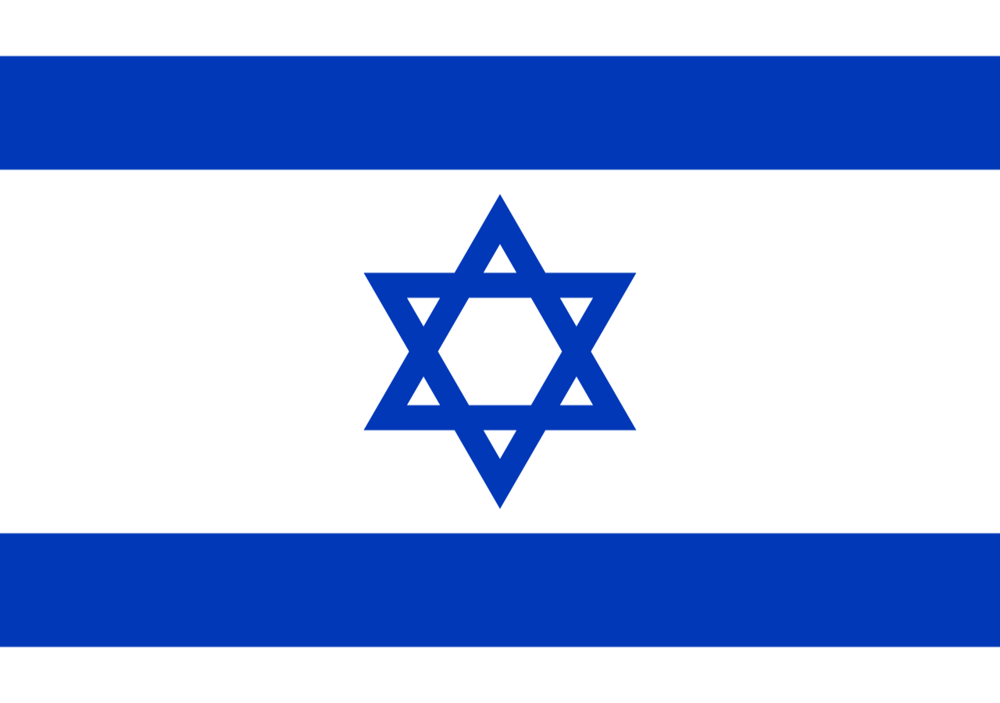

In [ ]:
from PIL import Image
Bandeira = Image.open('Bandeira-Israel.png')
Bandeira

In [ ]:
# Criar a Figura
Figura = make_subplots(
    rows=3,
    cols=1,
    specs=[
        [{'type':'table'}],
        [{'type':'bar'}],
        [{}]
    ],
    vertical_spacing=0.075,
    shared_xaxes=True,
    subplot_titles=('', 'Palavras mais frequentes', 'Nuvem de Palavras')
)

# Layout e Dimensão
Figura.update_layout(
    width=1000, height=1200, title_text='<b>Data Analytics</b> <br>Motor de Pesquisa'
)

# Adicionando o icone da Bandeira
Figura.add_layout_image(
    dict( source=Bandeira, x=1, y=1.02, sizex=0.07,
         sizey=0.07, xanchor='right', yanchor='bottom')
)

# Dados do cabeçalho e valores
cabecalho = ['Motor de busca de Notícias | Israel']
valores = Noticias[0:5]

LinhaBranca = 'white'
LinhaAzul = 'paleturquoise'

Figura.add_trace(
     go.Table(
            header=dict( values=cabecalho, fill_color='RoyalBlue', font_color='white', height=40, align='left', font_size=16 ),
            cells=dict( values=[valores], height=50, align='left', line_color='#f5f5f5', font_size=14,
                       fill_color=[[LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul,LinhaBranca, LinhaAzul ]] )
        ),
    row=1, col=1
)

# Adicionado um gráfico na 2º Posição
Figura.add_trace(
    go.Bar(
        x=Filtro_Top_20.Palavra,
        y=Filtro_Top_20.Quantidade,
        textposition="outside",
        texttemplate="%{x}",
        marker_color='royalblue',
    ),
    row=2, col=1
)

Anl_Nuvem = Image.open('Analise_Nuvem_Palavras.jpg')

# Adicionado um gráfico na 2º Posição
Figura.add_trace(
    go.Image(
        z=Anl_Nuvem,
        x0=0
    ),
    row=3, col=1
)

# Rodapes
Figura.add_annotation(
    showarrow=False,
    text='Análise feita no evento de IMERSÃO EM DADOS',
    font=dict(size=12),
    xref='x domain',
    x=1,
    yref='y domain',
    y=-1.4
)

Figura.add_annotation(
    showarrow=False,
    text='By: @Odemir Depieri Jr | @Ronisson Lucas Calmon',
    font=dict(size=12),
    xref='x domain',
    x=0,
    yref='y domain',
    y=-1.4
)

Figura